<a href="https://colab.research.google.com/github/Charlie-Davalos/Multiagentes/blob/main/Actividad_Integradora_A01706041.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install mesa matplotlib

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 65.6/65.6 kB 754.6 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 16.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.4/66.4 kB 5.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 25.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.9/105.9 kB 5.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 83.0/83.0 kB 1.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 16.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 71.9/71.9 kB 4.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.4/62.4 kB 3.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 130.2/130.2 kB 3.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.7/2.7 MB 22.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.1/6.1 MB 28.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [2]:
# Importar Librerías
from mesa import Agent, Model
from mesa.space import MultiGrid
from mesa.time import SimultaneousActivation
from mesa.datacollection import DataCollector

import matplotlib.pyplot as plt
import matplotlib.animation as animation
plt.rcParams["animation.html"] = "jshtml"

import numpy as np
import pandas as pd
import random

import time
import datetime

In [3]:
# Variables Globales y Funciones Auxiliares
# Variables que ayudan al funcionamiento del modelo
box_count = 0
boxes_in_stack = 0
robot_movements = 0

# Función que regresa la habitación o almacén
def get_room(model):
    room = np.zeros((model.grid.width, model.grid.height))
    for cell_content, (x, y) in model.grid.coord_iter():
        for content in cell_content:
            if isinstance(content, Robot):
                room[x][y] = content.robot_state
            else:
                room[x][y] = content.state
    return room

In [4]:
# Agente Robot
class Robot(Agent):
    BOX_ON_TOP = 4
    NO_BOX = 5

    # Constructor para inicializar el agente
    def __init__(self, unique_id, model, state=NO_BOX):
        super().__init__(unique_id, model)
        self.new_position = None
        self.movements = 0
        self.box_collected = False
        self.robot_state = state
        self.next_robot_state = None
        self.path_traveled = []

    # Función para establecer el precambio de posición y estado tanto del Robot como del Piso, aquí no se genera ningún cambio real
    def step(self):
        global box_count
        global boxes_in_stack

        neighbors = self.model.grid.get_neighbors(
            self.pos,
            moore=False,
            include_center=True)

        for neighbor in neighbors:
            if isinstance(neighbor, Floor) and neighbor.pos == self.pos:
                neighbor.next_state = neighbor.state
                if not self.box_collected:
                    if neighbor.next_state == neighbor.BOX:
                        neighbor.next_state = neighbor.EMPTY
                        self.new_position = self.pos
                        self.box_collected = True
                        self.next_robot_state = self.BOX_ON_TOP
                    else:
                        neighborhood2 = self.model.grid.get_neighbors(
                            self.pos,
                            moore=False,
                            include_center=False)
                        candidates = [n.pos for n in neighborhood2 if isinstance(n, Floor) and n.state != n.FULL_STACK and n.state != n.STACK]
                        candidates = [pos for pos in candidates if pos not in self.path_traveled]

                        if not candidates:
                            candidates = [n.pos for n in neighborhood2 if isinstance(n, Floor)]
                            self.path_traveled = []

                        new_position = self.random.choice(candidates)
                        self.path_traveled.append(new_position)
                        self.new_position = new_position
                        self.next_robot_state = self.NO_BOX
                else:
                    center_x, center_y = self.model.grid.width // 2, self.model.grid.height // 2
                    if (self.pos[0] == center_x and self.pos[1] == center_y) or (self.pos[0] == center_x and self.pos[1] == center_y - 1) or (self.pos[0] == center_x - 1 and self.pos[1] == center_y) or (self.pos[0] == center_x - 1 and self.pos[1] == center_y - 1):
                        if box_count != 5:
                            self.new_position = self.pos
                            self.box_collected = False
                            self.next_robot_state = self.NO_BOX
                            box_count += 1
                            boxes_in_stack += 1
                            neighbor.next_state = neighbor.STACK
                        else:
                            neighbor.next_state = neighbor.FULL_STACK
                            self.next_robot_state = self.BOX_ON_TOP
                            box_count = 0
                            self.new_position = self.pos
                    else:
                        # Moverse hacia el centro
                        dir_x = center_x - self.pos[0]
                        dir_y = center_y - self.pos[1]
                        new_position = (self.pos[0] + np.sign(dir_x), self.pos[1] + np.sign(dir_y))
                        self.new_position = new_position
                        self.next_robot_state = self.BOX_ON_TOP

                break

    # Función para realizar cambios reales de posiciones y estados de los agentes
    def advance(self):
        global robot_movements

        neighbors = self.model.grid.get_neighbors(
            self.pos,
            moore=False,
            include_center=True)

        for neighbor in neighbors:
            if isinstance(neighbor, Floor) and neighbor.pos == self.pos:
                neighbor.state = neighbor.next_state
                self.robot_state = self.next_robot_state
                break

        if self.pos != self.new_position:
            self.movements += 1
            robot_movements += 1

        self.model.grid.move_agent(self, self.new_position)

In [5]:
# Agente Piso
class Floor(Agent):
    FULL_STACK = 3
    STACK = 2
    BOX = 1
    EMPTY = 0

    # Constructor para inicializar el agente
    def __init__(self, pos, model, state=EMPTY):
        super().__init__(pos, model)
        self.x, self.y = pos
        self.state = state
        self.next_state = None

In [6]:
# Modelo Habitación
class Room(Model):
    global boxes_in_stack

    # Constructor para inicializar el modelo
    def __init__(self, m, n, num_agents, num_boxes):
        super().__init__()
        self.num_agents = num_agents
        self.num_boxes = num_boxes
        self.grid = MultiGrid(m, n, False)
        self.schedule = SimultaneousActivation(self)

        empty_cells_list = list(self.grid.empties)
        for _ in range(num_boxes):
            empty_cell = random.choice(empty_cells_list)
            floor = Floor(empty_cell, self)
            floor.state = floor.BOX
            self.grid.place_agent(floor, empty_cell)
            self.schedule.add(floor)
            empty_cells_list.remove(empty_cell)

        empty_cells_list = list(self.grid.empties)
        for cell in empty_cells_list:
            floor = Floor(cell, self)
            self.grid.place_agent(floor, cell)
            self.schedule.add(floor)

        for i in range(num_agents):
            robot = Robot(i, self)
            position = self.random.choice(empty_cells_list)
            self.grid.place_agent(robot, position)
            self.schedule.add(robot)
            empty_cells_list.remove(position)

        self.data_collector = DataCollector(
            model_reporters={'Room': get_room},
            agent_reporters={'Movements': lambda a: getattr(a, 'movements', None)}
        )

    # Genera el step del agente Robot y recolecta datos
    def step(self):
        self.data_collector.collect(self)
        self.schedule.step()

    # Termina la simulación si todas las celdas están vacías o apiladas
    def all_boxes_stacked(self):
        empty_cells = 0
        stacked_cells = 0
        full_stacked_cells = 0
        for cell_content, (x, y) in self.grid.coord_iter():
            for content in cell_content:
                if isinstance(content, Floor) and content.state == content.EMPTY:
                    empty_cells += 1
                if isinstance(content, Floor) and content.state == content.STACK:
                    stacked_cells += 1
                if isinstance(content, Floor) and content.state == content.FULL_STACK:
                    full_stacked_cells += 1

        self.clean_cells_percentage = (empty_cells + stacked_cells + full_stacked_cells) / (self.grid.width * self.grid.height)
        if self.clean_cells_percentage == 1 and boxes_in_stack == self.num_boxes:
            return True
        else:
            return False

In [7]:
# Ejecutar el Modelo
# Datos de la habitación:
M = 20
N = 20

# Número de agentes:
NUM_AGENTS = 5

# Número de cajas:
BOXES = 200

# Tiempo máximo de ejecución (segundos):
MAX_EXECUTION_TIME = 5

start_time = time.time()
model = Room(M, N, NUM_AGENTS, BOXES)

while (time.time() - start_time) < MAX_EXECUTION_TIME and not model.all_boxes_stacked():
    model.step()

# Imprimir el tiempo de ejecución y movimientos totales
execution_time = str(datetime.timedelta(seconds=(time.time() - start_time)))
print("Execution time: " + execution_time)
print("Total movements: " + str(robot_movements))

all_rooms = model.data_collector.get_model_vars_dataframe()

Execution time: 0:00:05.036697
Total movements: 12393


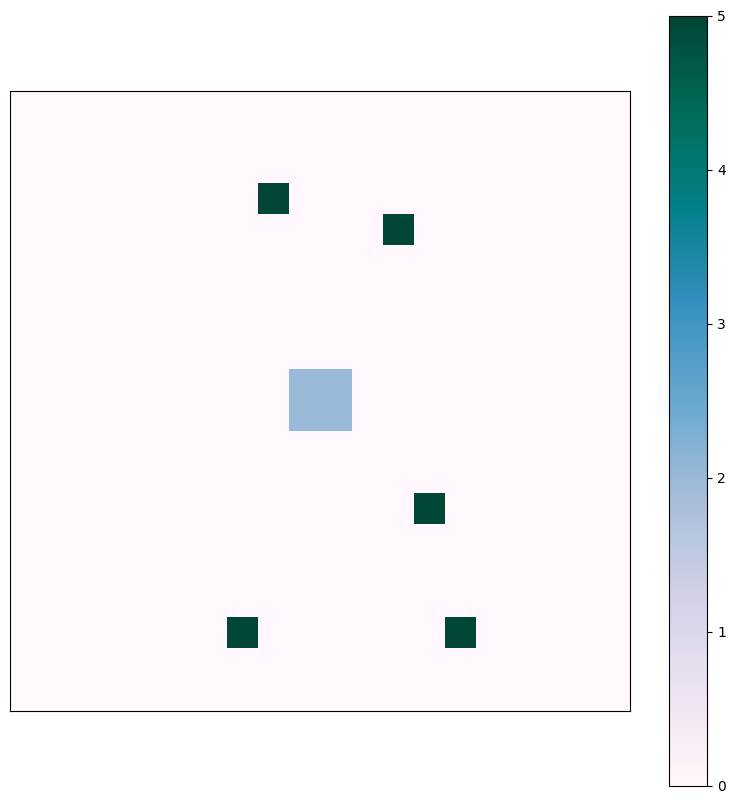

In [8]:
# Capturar y Animar el Gráfico
fig, axs = plt.subplots(figsize=(10, 10))
axs.set_xticks([])
axs.set_yticks([])
patch = plt.imshow(all_rooms.iloc[0][0], cmap='PuBuGn')
plt.colorbar(patch)

def animate(i):
    patch.set_data(all_rooms.iloc[i][0])

anim = animation.FuncAnimation(fig, animate, frames=len(all_rooms))

anim